In [1]:
import pandas as pd 
import numpy as np 
#import gc
from datetime import datetime
import matplotlib.pyplot as plt
import seaborn as sns 

# Read in the merged data 2.1

In [2]:
col_names = ['idx1', 'idx2', 'Id', 'EventTimeStamp', 'EquipmentID', 'DriverID', 'Latitude',
       'Longitude', 'LocationTimeStamp', 'Speed', 'Odometer', 'IgnitionStatus',
       'EFReportReason', 'TankLevelPercent', 'TankLevelGallons',
       'ExactFuelEventId', 'truck', 'tankcap', 'refuel_datetime',
       'refuel_tr_sum', 'refuel_tr_id']

date_cols = ['EventTimeStamp', 'LocationTimeStamp', 'refuel_datetime' ]

In [3]:
len(col_names)

21

In [4]:
dtype_dict = {
    'Id' : 'uint64', 
    'EquipmentID' : 'category', 
    'DriverID' : 'category', 
    'Latitude' : 'float64', 
    'Longitude' : 'float64', 
    'Speed' : 'uint16', 
    'Odometer' : 'float64', 
    'IgnitionStatus' : 'category', 
    'EFReportReason' : 'category', 
    'TankLevelPercent' : 'float32', 
    'TankLevelGallons' : 'float32', 
    'ExactFuelEventId' : 'uint64', 
    'truck' : 'category', 
    'tankcap' : 'uint16', 
    'refuel_tr_sum' : 'float32', 
    'refuel_tr_id' : 'category' }

In [5]:
## Read the csv after creating the dtype_dict, col_names, and date_cols objects
t0 = datetime.now()
print('started at ', t0)

events_levels_df = pd.read_csv('/Users/paulomartinez/Downloads/events_levels_df.gz', skiprows=1, names=col_names,
                               dtype=dtype_dict, usecols=np.arange(2,21), 
                              parse_dates = date_cols, infer_datetime_format = True)
tf = datetime.now()
print('finished at ', tf)
print('whole process took ', tf-t0)
events_levels_df.info(memory_usage='deep', null_counts=True)

started at  2018-05-04 20:35:31.456962
finished at  2018-05-04 20:36:25.314674
whole process took  0:00:53.857712
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7908406 entries, 0 to 7908405
Data columns (total 19 columns):
Id                   7908406 non-null uint64
EventTimeStamp       7908406 non-null datetime64[ns]
EquipmentID          7908406 non-null category
DriverID             7798523 non-null category
Latitude             7908406 non-null float64
Longitude            7908406 non-null float64
LocationTimeStamp    7908406 non-null datetime64[ns]
Speed                7908406 non-null uint16
Odometer             7908406 non-null float64
IgnitionStatus       7908406 non-null category
EFReportReason       7908406 non-null category
TankLevelPercent     7908406 non-null float32
TankLevelGallons     7908406 non-null float32
ExactFuelEventId     7908406 non-null uint64
truck                7908406 non-null category
tankcap              7908406 non-null uint16
refuel_datetime      7

# Drop the noisy rows

In [6]:
#list of noisy row ids
bad_row_Id = [12657126,
 12657127,
 12746275,
 12946311,
 13039741,
 13092342,
 13092343,
 13092344,
 13092345,
 13092346,
 13092347,
 13092555,
 13156996,
 13156997,
 13174091,
 13313530,
 13381098,
 13381099,
 13381100,
 13381101,
 13381102,
 13381103,
 13555164,
 13555165,
 13566460,
 13636409,
 13729945,
 13729946,
 13780017,
 13810682,
 13838489,
 13912193,
 13912251,
 13914679,
 13914680,
 13935785,
 14083809,
 14089445,
 14160586,
 14237432,
 14237433,
 14237448,
 14237449,
 14238192,
 14242725,
 14261769,
 14261770,
 14261771,
 14328059,
 14328060,
 14328061,
 14328062,
 14351176,
 14351177,
 14359863,
 14359864,
 14417642,
 14417643,
 14417644,
 14417645,
 14447049,
 14544626,
 14544627,
 14557081,
 14557505,
 14564960,
 14564961,
 14585667,
 14668575,
 14730292,
 14730293,
 14730294,
 14730295,
 14781469,
 14781470,
 14871213,
 14871214,
 14871215,
 14871237,
 14898651,
 14898652,
 14898653,
 14898654,
 14898655,
 14898656,
 14898657,
 14898658,
 14898659,
 14898660,
 14898661,
 14898662,
 14898663,
 14898664,
 14898665,
 14898666,
 14898667,
 14898668,
 14898669,
 14898670,
 14898671,
 14898672,
 14898673,
 14898674,
 14898675,
 14898676,
 14940092,
 14988050,
 14988052,
 14988053,
 14988054,
 15213067,
 15272473,
 15272474,
 15272475,
 15272476,
 15272477,
 15338152,
 15338153,
 15338154,
 15338155,
 15338156,
 15409791,
 15409792,
 15409793,
 15409794,
 15434374,
 15434375,
 15459392,
 15513384,
 15513385,
 15513386,
 15529682,
 15530029,
 15530030,
 15552006,
 15670484,
 15670485,
 15670486,
 15686110,
 15686111,
 15686139,
 15686140,
 15686141,
 15686142,
 15686143,
 15686144,
 15686145,
 15970716,
 15970719,
 15970720,
 16121249,
 16206897,
 16285004,
 16297322,
 16297323,
 16297324,
 16297325,
 16297326,
 16297327,
 16297328,
 16297329,
 16297330,
 16297331,
 16297332,
 16349951,
 16414146,
 16414147,
 16521380,
 16521381,
 16521382,
 16773389,
 16946873,
 16946874,
 16946875,
 17029642,
 17044451,
 17048531,
 17048532,
 17048533,
 17052293,
 17079226,
 17091437,
 17091438,
 17135503,
 17141248,
 17141249,
 17239056,
 17306363,
 17306364,
 17306365,
 17306366,
 17353645,
 17353647,
 17523789,
 17558391,
 17600517,
 17600518,
 17600519,
 17600520,
 17600521,
 17625382,
 17848054,
 18034883,
 18077107,
 18077136,
 18219769,
 18219770,
 18286629,
 18287766,
 18287797,
 18372956,
 18397269,
 18442627,
 18442628,
 18442629,
 18442630,
 18479608,
 18571739,
 18571740,
 18600441,
 18600444,
 18600445,
 18604899,
 18769793,
 18769794,
 18769795,
 18769796,
 18778132,
 18778133,
 18878427,
 18943054,
 18943055,
 18943056,
 18986682,
 19064535,
 19129470,
 19129471,
 19151185,
 19151187,
 19431189,
 19431190,
 19473744,
 19473747,
 19473748,
 19473749,
 19473750,
 19516211,
 19585856,
 19647247,
 19647248,
 19647249,
 19647307,
 19647308,
 19647309,
 19659265,
 19667110,
 19682036,
 19682037,
 19771347,
 19805675,
 19865184,
 19865185,
 19865186,
 19865187,
 19865188,
 19865189,
 19865190,
 19865191,
 19865192,
 19865193,
 19865194,
 19865195,
 19865196,
 19865197,
 19865198,
 19865199,
 19866576,
 19866577,
 19867559,
 19867560,
 19867561,
 19867562,
 19867563,
 19867564,
 19867891,
 19867892,
 19867893,
 19867894,
 19867895,
 19867896,
 19867897,
 19867898,
 19867899,
 19867900,
 19867901,
 19868038,
 19869152,
 19869153,
 19869463,
 19869464,
 19869465,
 19869466,
 19869467,
 19869468,
 19869469,
 19869587,
 19869588,
 19869589,
 19869590,
 19870675,
 19870676,
 19870677,
 19871176,
 19871177,
 19872846,
 19872847,
 19872848,
 19872849,
 19872850,
 19882277,
 19882278,
 19882279,
 19882280,
 19882281,
 19917072,
 19917073,
 19917074,
 19917075,
 19917076,
 19950534,
 19950535,
 19953297,
 19953300,
 19965259,
 19970595,
 20002163,
 20008440,
 20008443,
 20052156,
 20052455,
 20052456,
 20131852,
 20162872,
 20169350,
 20169351,
 20207146,
 20246645,
 20248564,
 20270484,
 20270487,
 20270488,
 20383219,
 20432075,
 20432104,
 20475553,
 20482760,
 20502251,
 20526997,
 20526998,
 20526999,
 20527000,
 20527090,
 20527091,
 20527092,
 20527093,
 20534852,
 20534853,
 20586712,
 20587078,
 20587079,
 20667306,
 20667307,
 20667932,
 20735846,
 20752293,
 20794736,
 20794737,
 20794738,
 20794739,
 20794740,
 20795223,
 20795224,
 20795225,
 20795226,
 20795227,
 20795545,
 20795546,
 20795547,
 20795550,
 20795551,
 20795553,
 20796460,
 20796461,
 20796462,
 20802387,
 20802388,
 20826624,
 20833078,
 20833079,
 20895567,
 20895568,
 20895569,
 20895570,
 20895571,
 20896364,
 20974377,
 20975272,
 20975273,
 20975274,
 20994196,
 21093100]

In [7]:
type(bad_row_Id[0])

int

In [8]:
#Jarrod says: For removing the bad rows, Pandas actually has good
#methods for creating a boolean series using a list or other criteria.
#Try this:

#redefine the df
t0 = datetime.now()
print('started at ', datetime.now())
bs2 = events_levels_df.Id.isin(bad_row_Id) == False
events_levels_df = events_levels_df[bs2]
tf = datetime.now()
print('finished at ', tf)
print('whole process took ', tf-t0)
print('')
events_levels_df.info(memory_usage='deep', null_counts=True)

started at  2018-05-04 20:36:30.131513
finished at  2018-05-04 20:36:32.148935
whole process took  0:00:02.017453

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7907995 entries, 0 to 7908405
Data columns (total 19 columns):
Id                   7907995 non-null uint64
EventTimeStamp       7907995 non-null datetime64[ns]
EquipmentID          7907995 non-null category
DriverID             7798159 non-null category
Latitude             7907995 non-null float64
Longitude            7907995 non-null float64
LocationTimeStamp    7907995 non-null datetime64[ns]
Speed                7907995 non-null uint16
Odometer             7907995 non-null float64
IgnitionStatus       7907995 non-null category
EFReportReason       7907995 non-null category
TankLevelPercent     7907995 non-null float32
TankLevelGallons     7907995 non-null float32
ExactFuelEventId     7907995 non-null uint64
truck                7907995 non-null category
tankcap              7907995 non-null uint16
refuel_datetime      

# Row dropping was successful ✅ 

#### Now I need to drop all rows with timestamps inside of the time range of consecutive refuelings
- to do this, I'll need to identify each trucks fueling purchases

It looks like Jarrod’s merge produced a litany of duplicate refuel_datetime values. ⛽️ ⛽️ ...⛽️ 

- ✅ This could make sense since every fuel level measurement that happened between refuel_datetime times might have received the preceding/merged refuel_datetime time-stamp.

Assuming this is the case, I should be able to run a modified version of my flag function to flag "inter-fueling-rows". 🇲🇽
- leaving us with a "feather-light" 89,976 rows

##### attempt to flag inter-fueling-rows

    🦂 
    Q: (is it possible that I would have dropped a noisy row that also happened to identify the next fueling event? 
    
    
    A: Perhaps, (although the odds of having this problem are only 411/7.9Million). Regardless, we should be fine, since the following row will have a sufficiently close timestamp and odometer reading.) 
    So, we're good to go 
    😁 🚀 

In [9]:
#sort by truck and date
t0 = datetime.now()
print('started at ', t0)
events_levels_df.sort_values(['truck', 'EventTimeStamp'],
                                     inplace = True
                                         )
tf = datetime.now()
print('finished at ', tf)
print('whole process took ', tf-t0)

events_levels_df
#started sort at 12:10 am - 12:10 am

started at  2018-05-04 20:36:35.981082
finished at  2018-05-04 20:36:42.677601
whole process took  0:00:06.696519


,Id,EventTimeStamp,EquipmentID,DriverID,Latitude,Longitude,LocationTimeStamp,Speed,Odometer,IgnitionStatus,EFReportReason,TankLevelPercent,TankLevelGallons,ExactFuelEventId,truck,tankcap,refuel_datetime,refuel_tr_sum,refuel_tr_id
2443,12804900,2017-01-09 08:03:30.687,1508,NaN,36.06612,-86.43410,2016-12-10 14:29:31,0,575630.9,1,1,25.200001,57.959999,12804900,1508,230,NaT,NaN,NaN
2445,12804901,2017-01-09 08:05:30.670,1508,NaN,36.06612,-86.43410,2016-12-10 14:29:31,0,575630.9,1,0,25.200001,57.959999,12804901,1508,230,NaT,NaN,NaN
2451,12804902,2017-01-09 08:17:10.670,1508,NaN,36.06612,-86.43410,2016-12-10 14:29:31,0,575631.0,2,1,25.200001,57.959999,12804902,1508,230,NaT,NaN,NaN
2514,12804904,2017-01-09 12:24:31.170,1508,NaN,36.06612,-86.43410,2016-12-10 14:29:31,0,575631.0,2,1,24.000000,55.200001,12804904,1508,230,NaT,NaN,NaN
2515,12804903,2017-01-09 12:25:41.203,1508,NaN,36.06612,-86.43410,2016-12-10 14:29:31,0,575631.0,2,0,24.000000,55.200001,12804903,1508,230,NaT,NaN,NaN
2530,12804905,2017-01-09 14:04:41.767,1508,NaN,36.06612,-86.43410,2016-12-10 14:29:31,0,575631.0,2,1,24.700001,56.810001,12804905,1508,230,NaT,NaN,NaN
2531,12804906,2017-01-09 14:06:31.780,1508,NaN,36.06612,-86.43410,2016-12-10 14:29:31,0,575631.0,2,0,24.700001,56.810001,12804906,1508,230,NaT,NaN,NaN
2535,12804907,2017-01-09 14:26:11.797,1508,NaN,36.06612,-86.43410,2016-12-10 14:29:31,0,575631.0,1,1,22.900000,52.669998,12804907,1508,230,NaT,NaN,NaN
2536,12804908,2017-01-09 14:28:21.813,1508,NaN,36.06612,-86.43410,2016-12-10 14:29:31,4,575631.0,1,0,23.000000,52.900002,12804908,1508,230,NaT,NaN,NaN
2543,12804899,2017-01-09 14:36:01.877,1508,NaN,36.06612,-86.43410,2016-12-10 14:29:31,0,575632.3,2,1,16.799999,38.639999,12804899,1508,230,NaT,NaN,NaN


In [10]:
#reset the index now that we have dropped the noisy odometer rows
t0 = datetime.now()
print('started at ', t0)
events_levels_df.reset_index(inplace = True, drop = True)
events_levels_df
tf = datetime.now()
print('finished at ', tf)
print('whole process took ', tf-t0)

started at  2018-05-04 20:36:42.755929
finished at  2018-05-04 20:36:42.764494
whole process took  0:00:00.008565


In [11]:
events_levels_df

,Id,EventTimeStamp,EquipmentID,DriverID,Latitude,Longitude,LocationTimeStamp,Speed,Odometer,IgnitionStatus,EFReportReason,TankLevelPercent,TankLevelGallons,ExactFuelEventId,truck,tankcap,refuel_datetime,refuel_tr_sum,refuel_tr_id
0,12804900,2017-01-09 08:03:30.687,1508,NaN,36.06612,-86.43410,2016-12-10 14:29:31,0,575630.9,1,1,25.200001,57.959999,12804900,1508,230,NaT,NaN,NaN
1,12804901,2017-01-09 08:05:30.670,1508,NaN,36.06612,-86.43410,2016-12-10 14:29:31,0,575630.9,1,0,25.200001,57.959999,12804901,1508,230,NaT,NaN,NaN
2,12804902,2017-01-09 08:17:10.670,1508,NaN,36.06612,-86.43410,2016-12-10 14:29:31,0,575631.0,2,1,25.200001,57.959999,12804902,1508,230,NaT,NaN,NaN
3,12804904,2017-01-09 12:24:31.170,1508,NaN,36.06612,-86.43410,2016-12-10 14:29:31,0,575631.0,2,1,24.000000,55.200001,12804904,1508,230,NaT,NaN,NaN
4,12804903,2017-01-09 12:25:41.203,1508,NaN,36.06612,-86.43410,2016-12-10 14:29:31,0,575631.0,2,0,24.000000,55.200001,12804903,1508,230,NaT,NaN,NaN
5,12804905,2017-01-09 14:04:41.767,1508,NaN,36.06612,-86.43410,2016-12-10 14:29:31,0,575631.0,2,1,24.700001,56.810001,12804905,1508,230,NaT,NaN,NaN
6,12804906,2017-01-09 14:06:31.780,1508,NaN,36.06612,-86.43410,2016-12-10 14:29:31,0,575631.0,2,0,24.700001,56.810001,12804906,1508,230,NaT,NaN,NaN
7,12804907,2017-01-09 14:26:11.797,1508,NaN,36.06612,-86.43410,2016-12-10 14:29:31,0,575631.0,1,1,22.900000,52.669998,12804907,1508,230,NaT,NaN,NaN
8,12804908,2017-01-09 14:28:21.813,1508,NaN,36.06612,-86.43410,2016-12-10 14:29:31,4,575631.0,1,0,23.000000,52.900002,12804908,1508,230,NaT,NaN,NaN
9,12804899,2017-01-09 14:36:01.877,1508,NaN,36.06612,-86.43410,2016-12-10 14:29:31,0,575632.3,2,1,16.799999,38.639999,12804899,1508,230,NaT,NaN,NaN


In [12]:
# Jarrod Johnson: Try this instead of the loop for just getting the fuel transactions
events_grp =events_levels_df[['DriverID', 'EventTimeStamp', 'EquipmentID',
                              'Odometer', 'refuel_tr_id', 'refuel_tr_sum', 
                              'refuel_datetime']].groupby(['DriverID', 'EquipmentID', 'refuel_datetime'])
events_grp

In [13]:
agg_dict = {'Odometer' : ['min', 'max'], 
           'EventTimeStamp' : ['first', 'last'], 
           'refuel_tr_id' : 'first', 
           'refuel_tr_sum' : 'first'}

t0 = datetime.now()
print('started at ', t0)

events_grp_df = events_grp.agg(agg_dict)
#I just don't understand what is going on here. 😔 
    #events_grp is a pandas.core.groupby.DataFrameGroupBy object 🤨
        #which apparently has a .agg method which takes an aggregation dictionary as an argument
        #And this apparently returns a dataframe🧐

tf = datetime.now()
print('finished at ', tf)
print('whole process took ', tf-t0)
print('')
events_grp_df.info(memory_usage='deep', null_counts=True)

started at  2018-05-04 20:36:43.090288
finished at  2018-05-04 20:36:55.827371
whole process took  0:00:12.737083

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 101112 entries, (ABBV, 1821, 2017-03-04 13:49:00) to (ZAMJ, 1588, 2017-06-01 08:14:00)
Data columns (total 6 columns):
(Odometer, min)            101112 non-null float64
(Odometer, max)            101112 non-null float64
(EventTimeStamp, first)    101112 non-null datetime64[ns]
(EventTimeStamp, last)     101112 non-null datetime64[ns]
(refuel_tr_id, first)      101078 non-null object
(refuel_tr_sum, first)     101112 non-null float32
dtypes: datetime64[ns](2), float32(1), float64(2), object(1)
memory usage: 11.3 MB


In [14]:
events_grp_df

Odometer            \
                                               min       max   
DriverID EquipmentID refuel_datetime                           
ABBV     1821        2017-03-04 13:49:00  233185.1  233502.4   
                     2017-03-29 12:32:00  174238.5  174485.7   
                     2017-03-30 16:51:00  174485.8  175213.3   
                     2017-04-01 08:27:00  175213.3  176005.3   
                     2017-04-01 12:28:00  176005.3  176228.5   
                     2017-04-02 14:43:00  176228.5  177030.0   
                     2017-04-04 13:03:00  177030.0  177898.2   
                     2017-04-07 03:45:00  177898.3  178702.9   
                     2017-04-07 15:58:00  178702.9  179277.8   
                     2017-04-10 16:20:00  179277.8  179806.3   
                     2017-04-12 18:33:00  179806.3  180680.6   
                     2017-04-13 14:18:00  180680.6  181138.2   
                     2017-04-14 20:15:00  181138.3  181780.6   
                     2017-04-15 16:58:00  181780.6  182338.4   
                     2017-04-16 12:46:00  182338.5  182859.2   
                     2017-04-17 13:23:00  182859.3  183342.2   
                     2017-04-19 13:35:00  183342.2  184134.9   
                     2017-04-20 02:53:00  184134.9  184290.0   
                     2017-04-21 02:18:00  184290.1  184918.5   
                     2017-04-22 02:00:00  184918.5  185537.8   
                     2017-04-24 15:14:00  185537.8  186342.3   
                     2017-04-25 09:40:00  186342.3  186834.5   
                     2017-04-25 13:23:00  186834.5  187036.8   
                     2017-04-27 05:41:00  187036.8  187796.6   
                     2017-04-28 11:44:00  187773.8  188547.6   
                     2017-05-01 19:18:00  188547.7  189204.3   
                     2017-05-03 16:33:00  189204.3  189957.3   
                     2017-05-08 11:50:00  189957.8  190813.0   
                     2017-05-09 10:00:00  190813.0  191432.9   
                     2017-05-10 06:27:00  191432.9  191924.2   
...                                            ...       ...   
ZAMJ     1588        2017-03-04 15:57:00  454560.8  454844.8   
                     2017-03-05 13:22:00  454844.8  455324.7   
                     2017-03-09 04:06:00  455324.8  456325.1   
                     2017-03-12 06:05:00  456325.1  457461.0   
                     2017-03-13 10:21:00  457461.0  457990.9   
                     2017-03-15 07:35:00  457990.9  458555.3   
                     2017-03-20 12:18:00  458555.6  459325.8   
                     2017-03-21 15:21:00  459325.8  460032.8   
                     2017-03-24 13:53:00  460032.8  461074.8   
                     2017-03-28 12:20:00  461074.8  462004.0   
                     2017-03-29 17:26:00  462004.8  462694.7   
                     2017-03-31 14:59:00  462694.8  463840.1   
                     2017-04-02 15:08:00  463840.1  464801.2   
                     2017-04-05 14:20:00  464801.2  465984.0   
                     2017-04-12 08:19:00  465984.0  467109.4   
                     2017-04-14 16:16:00  467109.6  468126.9   
                     2017-04-16 16:02:00  468126.9  469501.3   
                     2017-04-18 12:33:00  469501.4  469918.6   
                     2017-04-20 08:02:00  469918.7  470931.1   
                     2017-04-22 05:17:00  470931.2  471630.1   
                     2017-04-25 22:50:00  471630.1  472792.0   
                     2017-05-03 14:55:00  472792.2  473744.3   
                     2017-05-06 03:42:00  473744.3  474809.8   
                     2017-05-08 10:44:00  474809.8  475615.2   
                     2017-05-09 16:20:00  475615.2  476356.6   
                     2017-05-11 08:27:00  476356.7  476991.8   
                     2017-05-14 16:20:00  476991.8  478004.8   
                     2017-05-16 11:59:00  478005.7  478775.8   
                     2017-05-31 13:43:00  478775.8  479969.5   
          

Ok. I got it to run. But the resulting `events_grp_df` seems to have some issues.

- The first row doesn’t make sense.  (DriverId: ABBV)
    - The Odometer readings are anomalously higher than the second row
    - EventTimeStamps are over 5 months out of sync (and only seven hours in range).
- The second row looks ok. 
- But the first row of driver ADAG suffers from similar defects as the first row of ABBV

Also, what is the advantage of having a triple index like that and what appear to be nested columns names? I’m not sure how to select row ranges with this structured the way it is.

In [15]:
events_grp_df.head(700).tail(30)

Odometer            \
                                               min       max   
DriverID EquipmentID refuel_datetime                           
ALDS     1753        2017-11-04 09:01:00  383049.0  383933.1   
                     2017-11-07 07:29:00  383933.1  384661.9   
                     2017-11-08 16:30:00  384662.0  385361.8   
                     2017-11-11 13:07:00  385361.8  386191.1   
                     2017-11-14 15:35:00  386191.5  387078.0   
                     2017-11-15 07:52:00  387078.0  387416.4   
                     2017-11-17 07:32:00  387416.4  388321.5   
                     2017-11-20 13:10:00  388321.5  389147.2   
                     2017-11-22 12:54:00  389147.4  390034.5   
                     2017-11-23 13:05:00  390034.5  390791.3   
                     2017-11-28 14:57:00  390791.6  391454.2   
                     2017-11-30 15:37:00  391454.2  392512.2   
                     2017-12-04 12:04:00  392512.3  393401.7   
                     2017-12-05 23:11:00  393401.7  394183.9   
                     2017-12-06 20:52:00  394184.1  394658.6   
                     2017-12-09 13:12:00  394658.8  395447.4   
                     2017-12-12 11:29:00  395447.7  396363.8   
                     2017-12-14 16:59:00  396363.9  397079.7   
                     2017-12-18 14:19:00  397080.3  398068.1   
                     2017-12-20 15:52:00  398069.1  398851.2   
                     2017-12-26 12:26:00  398851.2  399883.6   
                     2017-12-27 17:08:00  399883.8  400599.1   
                     2017-12-29 18:50:00  400599.3  401514.1   
                     2018-01-03 19:52:00  401515.7  402277.1   
                     2018-01-06 12:08:00  402277.2  403091.1   
                     2018-01-09 13:06:00  403091.1  403765.7   
                     2018-01-11 11:37:00  429537.9  429658.1   
                     2018-01-12 13:35:00  403765.8  404736.2   
                     2018-01-14 18:00:00  404736.2  405546.5   
                     2018-01-16 11:09:00  405546.5  406349.7   

                                                  EventTimeStamp  \
                                                           first   
DriverID EquipmentID refuel_datetime                               
ALDS     1753        2017-11-04 09:01:00 2017-11-02 14:23:30.683   
                     2017-11-07 07:29:00 2017-11-04 09:04:14.673   
                     2017-11-08 16:30:00 2017-11-07 07:32:06.873   
                     2017-11-11 13:07:00 2017-11-08 16:32:45.790   
                     2017-11-14 15:35:00 2017-11-11 13:10:44.563   
                     2017-11-15 07:52:00 2017-11-14 15:36:03.793   
                     2017-11-17 07:32:00 2017-11-15 07:54:14.573   
                     2017-11-20 13:10:00 2017-11-17 07:34:36.347   
                     2017-11-22 12:54:00 2017-11-20 13:20:06.310   
                     2017-11-23 13:05:00 2017-11-22 12:55:14.350   
                     2017-11-28 14:57:00 2017-11-23 13:11:48.580   
                     2017-11-30 15:37:00 2017-11-28 14:57:13.420   
                     2017-12-04 12:04:00 2017-11-30 15:39:48.040   
                     2017-12-05 23:11:00 2017-12-04 12:05:28.843   
                     2017-12-06 20:52:00 2017-12-05 23:19:43.807   
                     2017-12-09 13:12:00 2017-12-06 20:58:49.597   
                     2017-12-12 11:29:00 2017-12-09 13:15:58.813   
                     2017-12-14 16:59:00 2017-12-12 11:32:32.250   
                     2017-12-18 14:19:00 2017-12-14 17:05:08.863   
                     2017-12-20 15:52:00 2017-12-18 14:24:11.470   
                     2017-12-26 12:26:00 2017-12-20 15:56:39.727   
                     2017-12-27 17:08:00 2017-12-26 12:30:00.217   
                     2017-12-29 18:50:00 2017-12-27 17:18:12.787   
                     2018-01-03 19:52:00 2017-12-29 18:56:28.263   
                     2018-01-06 12:08:00 2018-01-03 20:00:06.757   
                     2018

In [16]:
events_grp_df.columns

MultiIndex(levels=[['Odometer', 'EventTimeStamp', 'refuel_tr_id', 'refuel_tr_sum'], ['first', 'last', 'max', 'min']],
           labels=[[0, 0, 1, 1, 2, 3], [3, 2, 0, 1, 0, 0]])

since I'm 😱 spooked by the multiindex, maybe I can just reset it

In [17]:
events_grp_df.reset_index(inplace = True, drop = False)

In [18]:
events_grp_df

DriverID EquipmentID     refuel_datetime  Odometer            \
                                                      min       max   
0          ABBV        1821 2017-03-04 13:49:00  233185.1  233502.4   
1          ABBV        1821 2017-03-29 12:32:00  174238.5  174485.7   
2          ABBV        1821 2017-03-30 16:51:00  174485.8  175213.3   
3          ABBV        1821 2017-04-01 08:27:00  175213.3  176005.3   
4          ABBV        1821 2017-04-01 12:28:00  176005.3  176228.5   
5          ABBV        1821 2017-04-02 14:43:00  176228.5  177030.0   
6          ABBV        1821 2017-04-04 13:03:00  177030.0  177898.2   
7          ABBV        1821 2017-04-07 03:45:00  177898.3  178702.9   
8          ABBV        1821 2017-04-07 15:58:00  178702.9  179277.8   
9          ABBV        1821 2017-04-10 16:20:00  179277.8  179806.3   
10         ABBV        1821 2017-04-12 18:33:00  179806.3  180680.6   
11         ABBV        1821 2017-04-13 14:18:00  180680.6  181138.2   
12         ABBV        1821 2017-04-14 20:15:00  181138.3  181780.6   
13         ABBV        1821 2017-04-15 16:58:00  181780.6  182338.4   
14         ABBV        1821 2017-04-16 12:46:00  182338.5  182859.2   
15         ABBV        1821 2017-04-17 13:23:00  182859.3  183342.2   
16         ABBV        1821 2017-04-19 13:35:00  183342.2  184134.9   
17         ABBV        1821 2017-04-20 02:53:00  184134.9  184290.0   
18         ABBV        1821 2017-04-21 02:18:00  184290.1  184918.5   
19         ABBV        1821 2017-04-22 02:00:00  184918.5  185537.8   
20         ABBV        1821 2017-04-24 15:14:00  185537.8  186342.3   
21         ABBV        1821 2017-04-25 09:40:00  186342.3  186834.5   
22         ABBV        1821 2017-04-25 13:23:00  186834.5  187036.8   
23         ABBV        1821 2017-04-27 05:41:00  187036.8  187796.6   
24         ABBV        1821 2017-04-28 11:44:00  187773.8  188547.6   
25         ABBV        1821 2017-05-01 19:18:00  188547.7  189204.3   
26         ABBV        1821 2017-05-03 16:33:00  189204.3  189957.3   
27         ABBV        1821 2017-05-08 11:50:00  189957.8  190813.0   
28         ABBV        1821 2017-05-09 10:00:00  190813.0  191432.9   
29         ABBV        1821 2017-05-10 06:27:00  191432.9  191924.2   
...         ...         ...                 ...       ...       ...   
101082     ZAMJ        1588 2017-03-04 15:57:00  454560.8  454844.8   
101083     ZAMJ        1588 2017-03-05 13:22:00  454844.8  455324.7   
101084     ZAMJ        1588 2017-03-09 04:06:00  455324.8  456325.1   
101085     ZAMJ        1588 2017-03-12 06:05:00  456325.1  457461.0   
101086     ZAMJ        1588 2017-03-13 10:21:00  457461.0  457990.9   
101087     ZAMJ        1588 2017-03-15 07:35:00  457990.9  458555.3   
101088     ZAMJ        1588 2017-03-20 12:18:00  458555.6  459325.8   
101089     ZAMJ        1588 2017-03-21 15:21:00  459325.8  460032.8   
101090     ZAMJ        1588 2017-03-24 13:53:00  460032.8  461074.8   
101091     ZAMJ        1588 2017-03-28 12:20:00  461074.8  462004.0   
101092     ZAMJ        1588 2017-03-29 17:26:00  462004.8  462694.7   
101093     ZAMJ        1588 2017-03-31 14:59:00  462694.8  463840.1   
101094     ZAMJ        1588 2017-04-02 15:08:00  463840.1  464801.2   
101095     ZAMJ        1588 2017-04-05 14:20:00  464801.2  465984.0   
101096     ZAMJ        1588 2017-04-12 08:19:00  465984.0  467109.4   
101097     ZAMJ        1588 2017-04-14 16:16:00  467109.6  468126.9   
101098     ZAMJ        1588 2017-04-16 16:02:00  468126.9  469501.3   
101099     ZAMJ        1588 2017-04-18 12:33:00  469501.4  469918.6   
101100     ZAMJ        1588 2017-04-20 08:02:00  469918.7  470931.1   
101101     ZAMJ        1588 2017-04-22 05:17:00  470931.2  471630.1   
101102     ZAMJ        1588 2017-04-25 22:50:00  471630.1  472792.0   
101103     ZAMJ        1588 2017-05-03 14:55:00  472792.2  473744.3   
101104     ZAMJ        1588 2017-05-06 03:42:00  473744.3  474809.8   
101105     ZAMJ        1588 201

In [19]:
events_grp_df.columns = ['driver', 'truck', 'refuel_datetime', 'odom_min', 
                         'odom_max', 'fueltank_reading_first', 'fueltank_reading_last',
                        'refueling_trans_id_first', 'refueling_sum_first']
events_grp_df

,driver,truck,refuel_datetime,odom_min,odom_max,fueltank_reading_first,fueltank_reading_last,refueling_trans_id_first,refueling_sum_first
0,ABBV,1821,2017-03-04 13:49:00,233185.1,233502.4,2017-08-23 12:49:07.703,2017-08-23 19:02:46.300,50015035,124.010002
1,ABBV,1821,2017-03-29 12:32:00,174238.5,174485.7,2017-03-29 06:16:12.873,2017-03-29 12:30:06.890,53074887,91.660004
2,ABBV,1821,2017-03-30 16:51:00,174485.8,175213.3,2017-03-29 12:34:46.937,2017-03-30 16:44:39.553,53262743,106.059998
3,ABBV,1821,2017-04-01 08:27:00,175213.3,176005.3,2017-03-30 16:52:49.570,2017-04-01 08:25:48.280,53458188,50.840000
4,ABBV,1821,2017-04-01 12:28:00,176005.3,176228.5,2017-04-01 08:27:48.280,2017-04-01 12:23:59.467,53480705,91.970001
5,ABBV,1821,2017-04-02 14:43:00,176228.5,177030.0,2017-04-01 12:30:29.497,2017-04-02 14:38:43.843,53575090,97.889999
6,ABBV,1821,2017-04-04 13:03:00,177030.0,177898.2,2017-04-02 14:44:53.843,2017-04-04 12:59:32.553,53809952,111.389999
7,ABBV,1821,2017-04-07 03:45:00,177898.3,178702.9,2017-04-04 13:05:32.587,2017-04-07 03:40:36.027,54188669,103.419998
8,ABBV,1821,2017-04-07 15:58:00,178702.9,179277.8,2017-04-07 03:50:26.090,2017-04-07 15:52:47.500,54271159,95.699997
9,ABBV,1821,2017-04-10 16:20:00,179277.8,179806.3,2017-04-07 16:01:07.547,2017-04-10 16:17:18.390,54575977,61.849998


In [20]:
events_grp_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101112 entries, 0 to 101111
Data columns (total 9 columns):
driver                      101112 non-null category
truck                       101112 non-null category
refuel_datetime             101112 non-null datetime64[ns]
odom_min                    101112 non-null float64
odom_max                    101112 non-null float64
fueltank_reading_first      101112 non-null datetime64[ns]
fueltank_reading_last       101112 non-null datetime64[ns]
refueling_trans_id_first    101078 non-null object
refueling_sum_first         101112 non-null float32
dtypes: category(2), datetime64[ns](3), float32(1), float64(2), object(1)
memory usage: 5.5+ MB


In [21]:
events_grp_df.columns

Index(['driver', 'truck', 'refuel_datetime', 'odom_min', 'odom_max',
       'fueltank_reading_first', 'fueltank_reading_last',
       'refueling_trans_id_first', 'refueling_sum_first'],
      dtype='object')

## Ok, let's explore our dataframe

In [22]:
events_grp_df.truck.value_counts()

2003    345
1750    329
1792    326
1957    318
1716    301
307     300
1814    295
308     293
1734    292
1830    289
1952    287
2001    285
1941    275
1877    274
1881    274
1926    271
1722    271
1995    271
1755    270
1934    267
1852    266
1870    266
1912    265
1787    264
1784    264
1847    264
1717    262
1741    261
1845    260
1812    259
       ... 
1569     17
1537     17
303      16
301      14
1614     10
1525      8
2147      4
1625      4
2151      4
2152      4
2153      4
1548      4
2154      4
2150      4
2144      3
2148      3
1513      2
1627      2
1628      2
2146      2
2155      2
1636      1
1622      1
1621      1
1617      1
2156      1
1635      0
1519      0
1516      0
1508      0
Name: truck, Length: 629, dtype: int64

In [23]:
events_grp_df.driver.value_counts()

VAUJAM     348
ECKS       339
CLIJ       329
CHRN       326
ARCM       301
WILANT     301
BLACH      300
ROBJEF     299
AMMC       297
CRAC       293
WILMIC     289
DEASA      288
GALJU      286
CARDE      283
DOBE       283
BROD03     279
KORR       276
SAVE       275
BYRCHR     275
LONRO      274
GRIST      272
BOUB       272
CARRO      272
JONCH      271
AUSTE      271
TUSR       268
ULAL       267
COTALV     267
SIMJIM     265
RODMAR     264
          ... 
MORTIM       2
HAYM         1
ADADE        0
WILSO3       0
ACHC         0
CARJ01       0
WILRON       0
TAYDO1       0
CRAIG B      0
BYRCHI       0
HEAD         0
STAW         0
FURLA        0
HOLW1        0
HARGR        0
KINCA        0
KUNDAV       0
GODJO        0
BEAT         0
MEID         0
BANJA        0
SNID         0
DENJE        0
RUDD         0
SCHJ         0
DAVKEN       0
SHOP1        0
SHOP2        0
SHOP3        0
36728        0
Name: driver, Length: 924, dtype: int64

In [24]:
for c in events_grp_df.columns:
    print('unique vals in', c, ':', len(set(events_grp_df[c])))

unique vals in driver : 896
unique vals in truck : 625
unique vals in refuel_datetime : 89975
unique vals in odom_min : 100067
unique vals in odom_max : 100038
unique vals in fueltank_reading_first : 101110
unique vals in fueltank_reading_last : 101111
unique vals in refueling_trans_id_first : 99316
unique vals in refueling_sum_first : 14626


# Alright, let's see if we can plot some odometer readings

In [25]:
events_grp_df

,driver,truck,refuel_datetime,odom_min,odom_max,fueltank_reading_first,fueltank_reading_last,refueling_trans_id_first,refueling_sum_first
0,ABBV,1821,2017-03-04 13:49:00,233185.1,233502.4,2017-08-23 12:49:07.703,2017-08-23 19:02:46.300,50015035,124.010002
1,ABBV,1821,2017-03-29 12:32:00,174238.5,174485.7,2017-03-29 06:16:12.873,2017-03-29 12:30:06.890,53074887,91.660004
2,ABBV,1821,2017-03-30 16:51:00,174485.8,175213.3,2017-03-29 12:34:46.937,2017-03-30 16:44:39.553,53262743,106.059998
3,ABBV,1821,2017-04-01 08:27:00,175213.3,176005.3,2017-03-30 16:52:49.570,2017-04-01 08:25:48.280,53458188,50.840000
4,ABBV,1821,2017-04-01 12:28:00,176005.3,176228.5,2017-04-01 08:27:48.280,2017-04-01 12:23:59.467,53480705,91.970001
5,ABBV,1821,2017-04-02 14:43:00,176228.5,177030.0,2017-04-01 12:30:29.497,2017-04-02 14:38:43.843,53575090,97.889999
6,ABBV,1821,2017-04-04 13:03:00,177030.0,177898.2,2017-04-02 14:44:53.843,2017-04-04 12:59:32.553,53809952,111.389999
7,ABBV,1821,2017-04-07 03:45:00,177898.3,178702.9,2017-04-04 13:05:32.587,2017-04-07 03:40:36.027,54188669,103.419998
8,ABBV,1821,2017-04-07 15:58:00,178702.9,179277.8,2017-04-07 03:50:26.090,2017-04-07 15:52:47.500,54271159,95.699997
9,ABBV,1821,2017-04-10 16:20:00,179277.8,179806.3,2017-04-07 16:01:07.547,2017-04-10 16:17:18.390,54575977,61.849998


In [26]:
#actually, I don't want the data grouped by driver. I want it grouped by truck, then chronologically
events_grp_df.sort_values(['truck', 'refuel_datetime'], inplace = True)
events_grp_df

,driver,truck,refuel_datetime,odom_min,odom_max,fueltank_reading_first,fueltank_reading_last,refueling_trans_id_first,refueling_sum_first
3822,BAIJO,1513,2017-01-01 12:11:00,529067.8,529067.9,2017-01-01 08:12:27.390,2017-01-01 12:08:18.090,42598121,50.020000
3823,BAIJO,1513,2017-01-03 06:37:00,529067.9,529407.2,2017-01-01 12:13:27.997,2017-01-02 10:18:39.780,42715248,98.320000
59326,MARMIS,1520,2017-01-06 11:30:00,570092.6,570221.9,2017-01-06 06:21:17.233,2017-01-06 11:18:18.373,43145435,80.300003
59327,MARMIS,1520,2017-01-07 16:05:00,570222.7,570856.6,2017-01-06 11:33:58.420,2017-01-07 16:04:34.150,43284870,146.509995
59328,MARMIS,1520,2017-01-10 13:20:00,570856.6,571751.4,2017-01-07 16:06:04.167,2017-01-10 13:12:43.093,43581386,155.440002
59329,MARMIS,1520,2017-01-11 17:47:00,571751.9,572621.6,2017-01-10 13:23:43.107,2017-01-11 17:40:43.720,43754441,111.720001
59330,MARMIS,1520,2017-01-13 19:15:00,572621.6,573577.5,2017-01-11 17:50:03.783,2017-01-13 19:01:27.210,44034860,152.970001
59331,MARMIS,1520,2017-01-18 13:58:00,573577.5,574596.3,2017-01-13 19:18:07.257,2017-01-18 13:48:13.920,44537473,149.130005
59332,MARMIS,1520,2017-01-20 08:51:00,574596.5,575546.1,2017-01-18 14:01:23.967,2017-01-20 08:43:39.683,44765472,146.479996
59333,MARMIS,1520,2017-01-23 16:40:00,575546.4,576531.0,2017-01-20 08:55:59.777,2017-01-23 16:37:04.193,45099180,54.080002


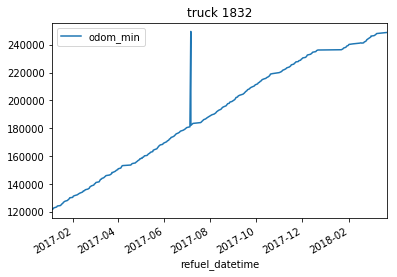

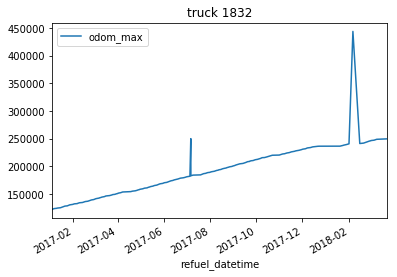

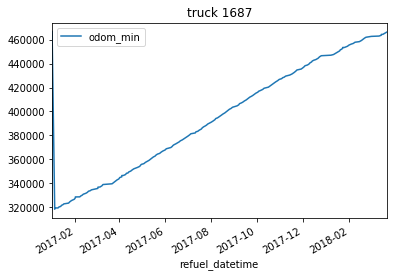

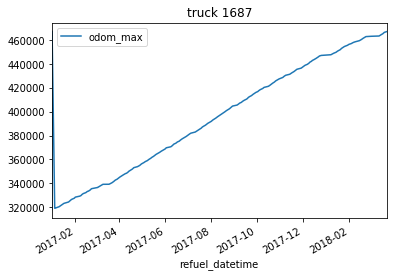

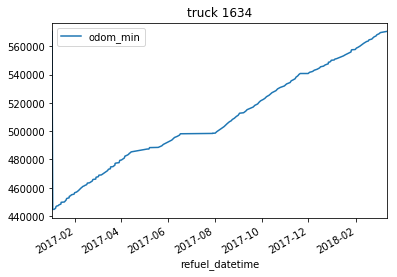

...

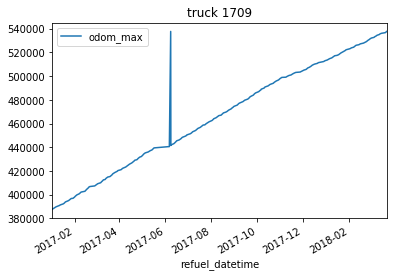

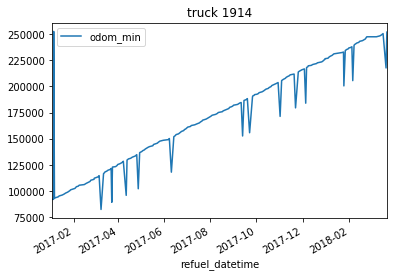

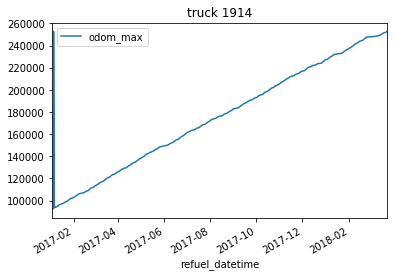

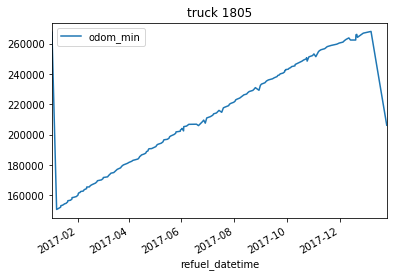

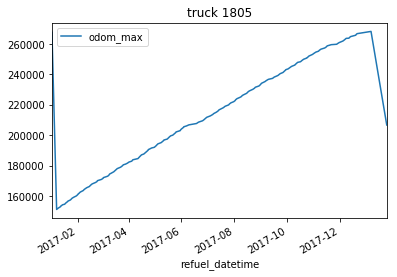

/Users/paulomartinez/anaconda3/lib/python3.6/site-packages/matplotlib/axes/_base.py:2917: UserWarning: Attempting to set identical left==right results
in singular transformations; automatically expanding.
left=736337.779861, right=736337.779861
  'left=%s, right=%s') % (left, right))


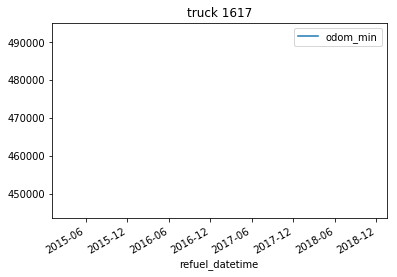

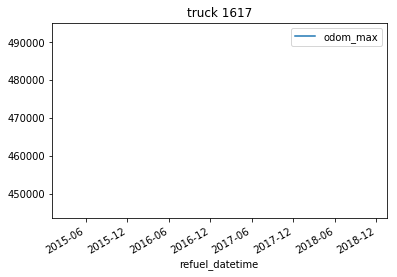

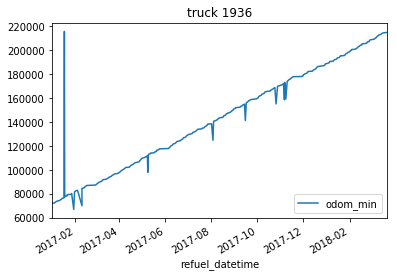

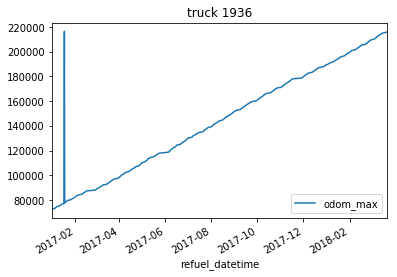

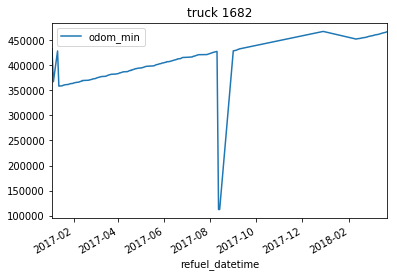

...

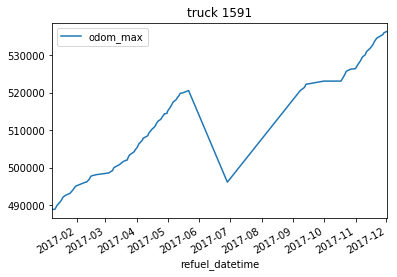

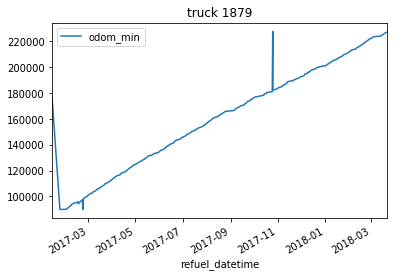

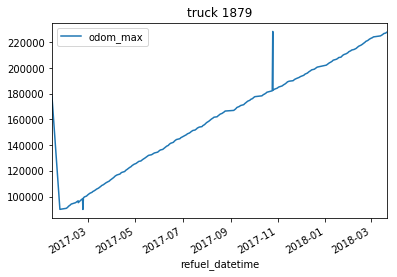

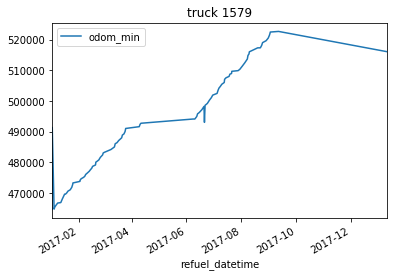

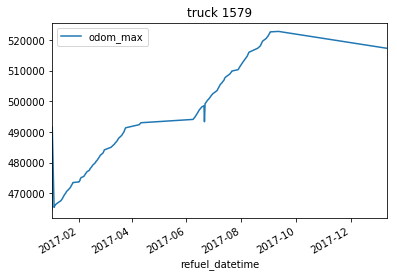

/Users/paulomartinez/anaconda3/lib/python3.6/site-packages/matplotlib/axes/_base.py:2917: UserWarning: Attempting to set identical left==right results
in singular transformations; automatically expanding.
left=736332.341667, right=736332.341667
  'left=%s, right=%s') % (left, right))


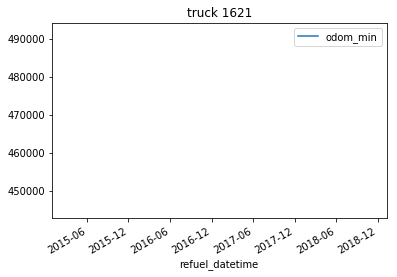

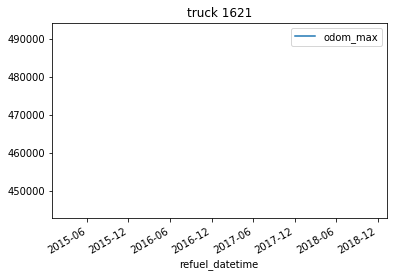

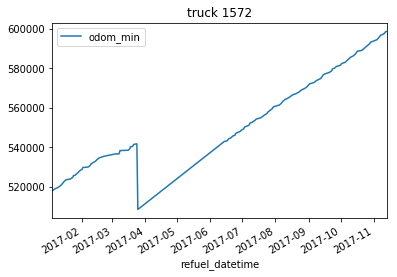

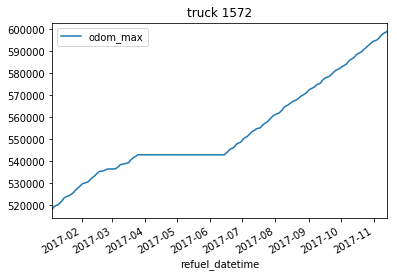

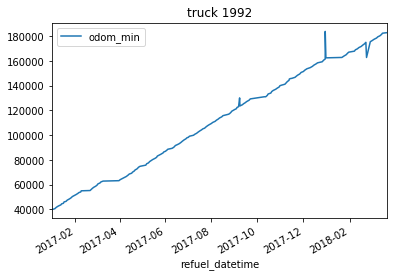

...

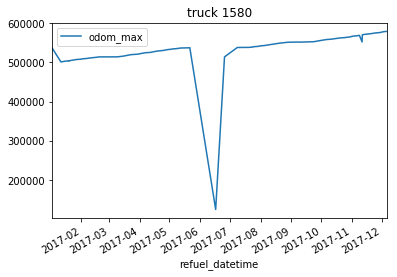

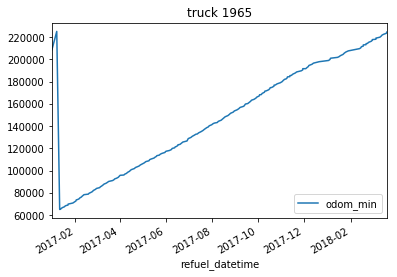

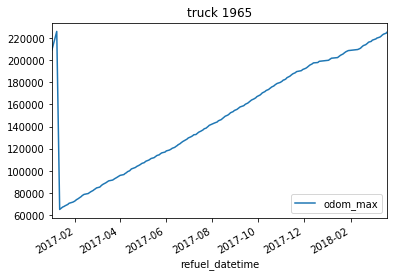

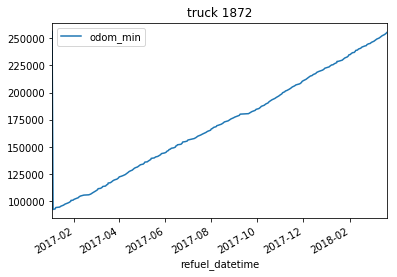

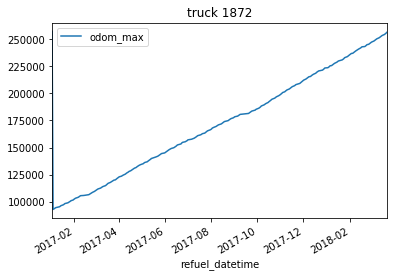

/Users/paulomartinez/anaconda3/lib/python3.6/site-packages/matplotlib/axes/_base.py:2917: UserWarning: Attempting to set identical left==right results
in singular transformations; automatically expanding.
left=736331.427083, right=736331.427083
  'left=%s, right=%s') % (left, right))


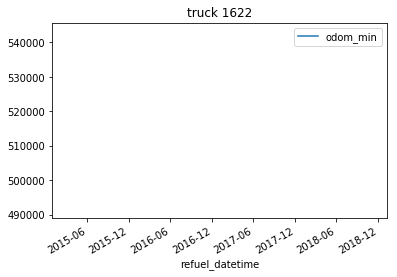

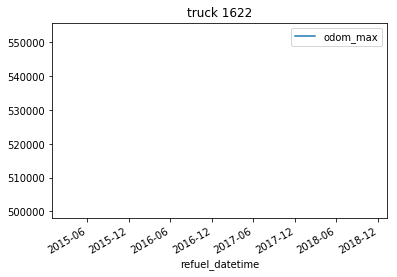

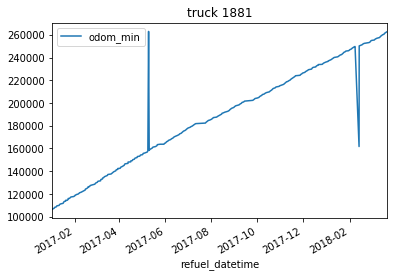

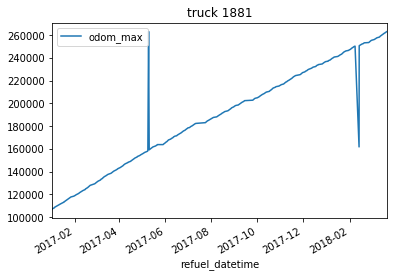

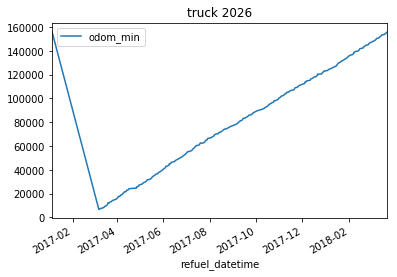

...

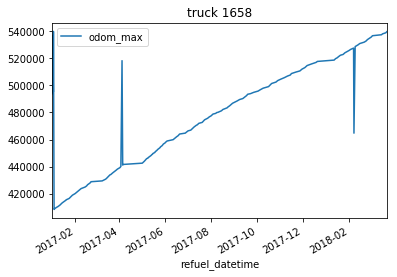

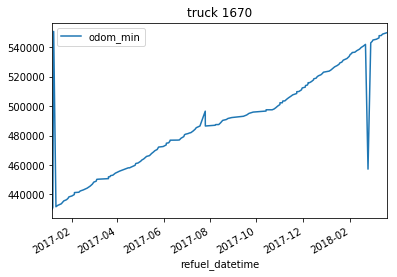

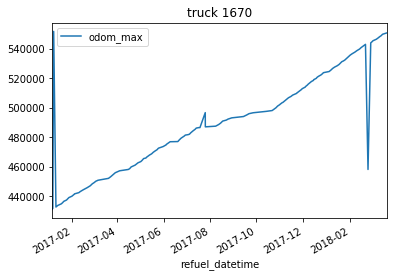

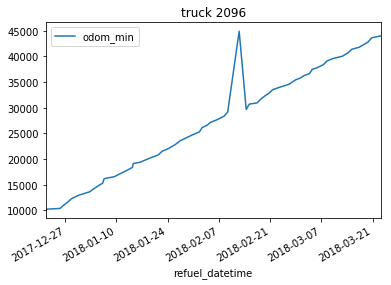

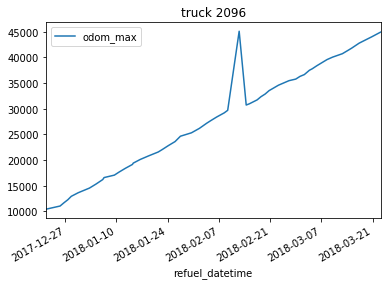

/Users/paulomartinez/anaconda3/lib/python3.6/site-packages/matplotlib/axes/_base.py:2917: UserWarning: Attempting to set identical left==right results
in singular transformations; automatically expanding.
left=736637.436806, right=736637.436806
  'left=%s, right=%s') % (left, right))


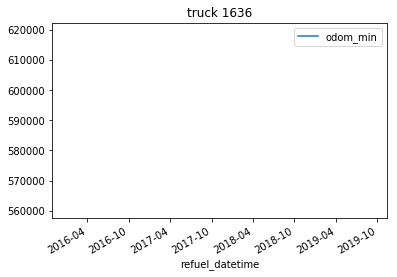

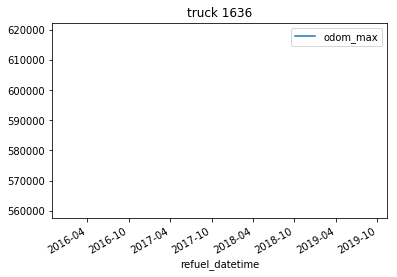

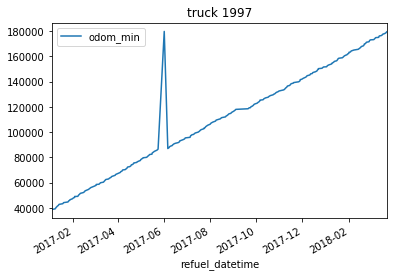

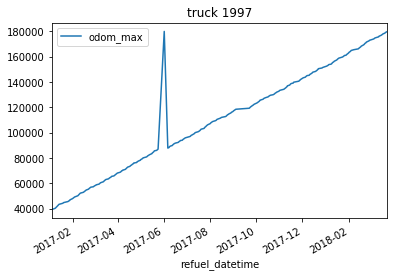

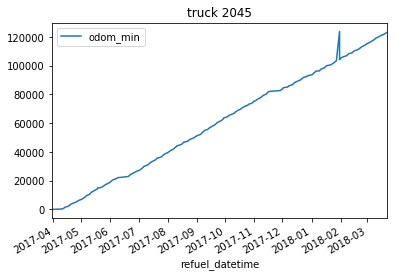

...

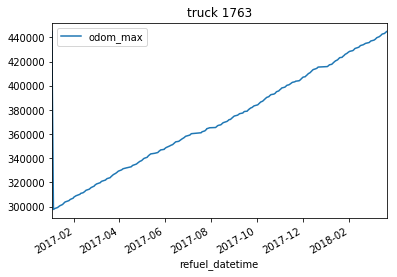

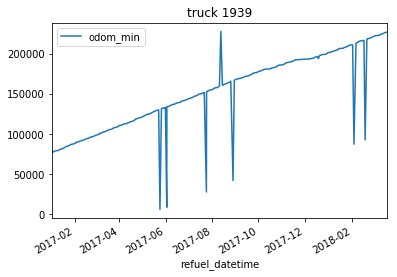

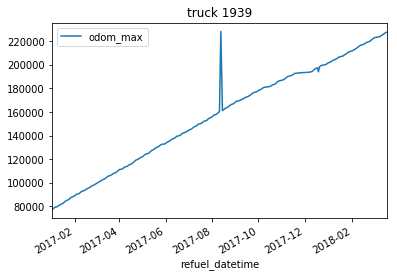

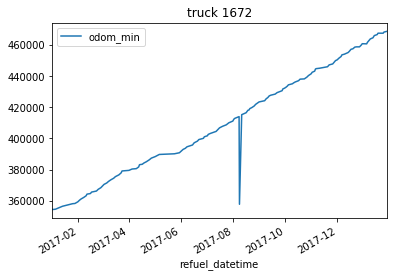

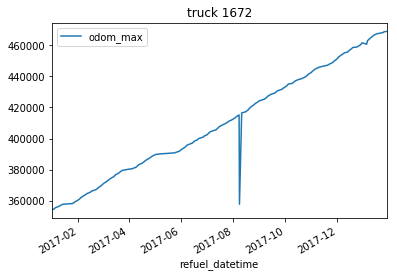

/Users/paulomartinez/anaconda3/lib/python3.6/site-packages/matplotlib/axes/_base.py:2917: UserWarning: Attempting to set identical left==right results
in singular transformations; automatically expanding.
left=736331.675694, right=736331.675694
  'left=%s, right=%s') % (left, right))


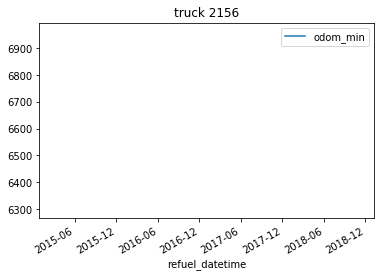

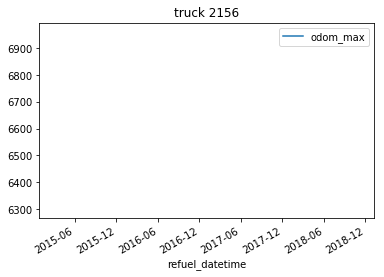

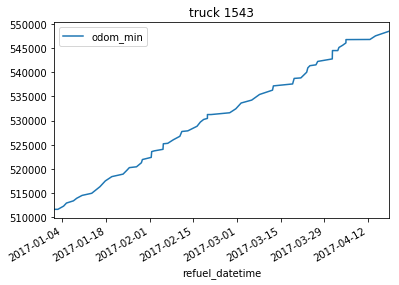

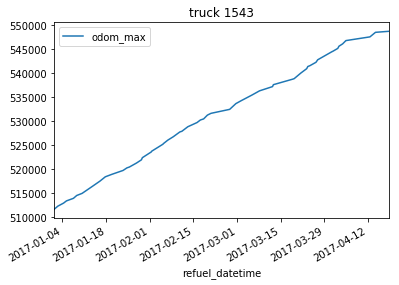

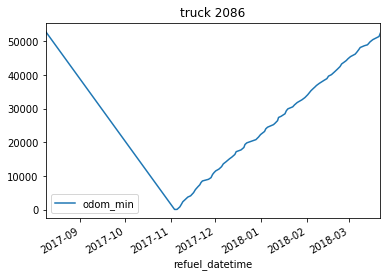

...

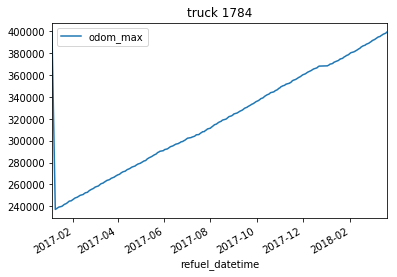

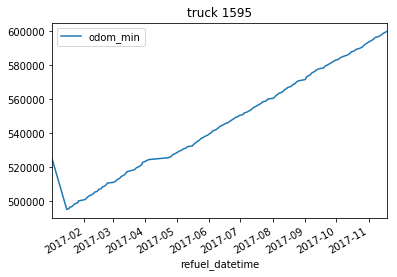

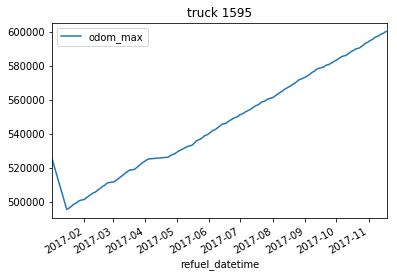

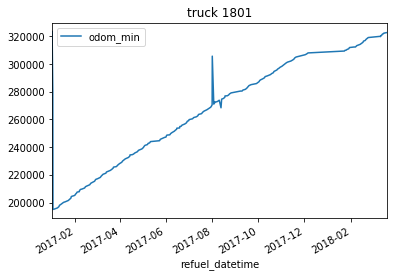

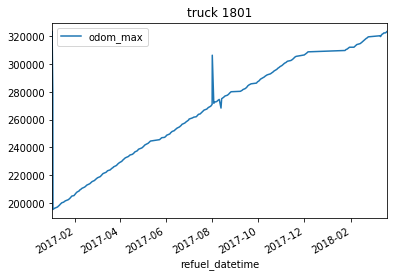

In [27]:
#this cell will generate 629 odometer plot series. One for every truck.

for truck in list(set(events_grp_df.truck)):
    _ = events_grp_df[events_grp_df.truck == truck].plot(x = 'refuel_datetime', y = 'odom_min', 
                                                               title = 'truck ' + str(truck))
    _ = events_grp_df[events_grp_df.truck == truck].plot(x = 'refuel_datetime', y = 'odom_max', 
                                                               title = 'truck ' + str(truck))
    plt.show()

In [32]:
events_grp_df

KeyError: '[0] not in index'